# EDA

## Import

In [1]:
import numpy as np

import pandas as pd
pd.set_option('display.float_format', '{:.4f}'.format)
pd.set_option('display.max_rows', 93)

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

import warnings

# Отключить все предупреждения временно
warnings.filterwarnings("ignore")

# Ваш код, вызывающий предупреждение о переполнении

# Включить предупреждения обратно
# warnings.filterwarnings("default")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
train_df = pd.read_parquet("/content/drive/MyDrive/Alfa-hak/train_data.pqt")
test_df = pd.read_parquet("/content/drive/MyDrive/Alfa-hak/test_data.pqt")


cat_cols = [
    "channel_code", "city", "city_type",
    "okved", "segment", "start_cluster",
    "index_city_code", "ogrn_month", "ogrn_year",
]


train_df[cat_cols] = train_df[cat_cols].astype("category")
test_df[cat_cols] = test_df[cat_cols].astype("category")

df = pd.concat([train_df, test_df], ignore_index = True)

## Funcs

In [6]:
def all_column_summary(df):
    """Для описания всех столбцов"""
    summary_data = []

    for col_name in df.columns:
        col_dtype = df[col_name].dtype
        num_of_nulls = df[col_name].isnull().sum()
        num_of_non_nulls = df[col_name].notnull().sum()
        num_of_distinct_values = df[col_name].nunique()

        if num_of_distinct_values <= 10:
            distinct_values_counts = df[col_name].value_counts().to_dict()
        else:
            top_10_values_counts = df[col_name].value_counts().head(10).to_dict()
            distinct_values_counts = {k: v for k, v in sorted(top_10_values_counts.items(), key=lambda item: item[1], reverse=True)}

        summary_data.append({
            'col_name': col_name,
            'col_dtype': col_dtype,
            'num_of_nulls': num_of_nulls,
            'num_of_non_nulls': num_of_non_nulls,
            'num_of_distinct_values': num_of_distinct_values,
            'distinct_values_counts': distinct_values_counts
        })

    summary_df = pd.DataFrame(summary_data)
    return summary_df

def num_column_summary(df):
    """Для численных всех столбцов"""

    df = df.select_dtypes(include="number")
    summary_data = []

    for col_name in df.columns:
        col_dtype = df[col_name].dtype
        num_of_nulls = df[col_name].isnull().sum()
        num_of_non_nulls = df[col_name].notnull().sum()
        num_of_distinct_values = df[col_name].nunique()
        mean = df[col_name].mean()
        std = df[col_name].std()
        min_val = df[col_name].min()
        q25 = df[col_name].quantile(0.25)
        q50 = df[col_name].quantile(0.50)
        q75 = df[col_name].quantile(0.75)
        max_val = df[col_name].max()


        if num_of_distinct_values <= 10:
            distinct_values_counts = df[col_name].value_counts().to_dict()
        else:
            top_10_values_counts = df[col_name].value_counts().head(10).to_dict()
            distinct_values_counts = {k: v for k, v in sorted(top_10_values_counts.items(), key=lambda item: item[1], reverse=True)}

        summary_data.append({
            'col_name': col_name,
            'col_dtype': col_dtype,
            'num_of_nulls': num_of_nulls,
            'num_of_non_nulls': num_of_non_nulls,
            'num_of_distinct_values': num_of_distinct_values,
            'mean': mean,
            'std': std,
            'min': min_val,
            'q25': q25,
            'q50': q50,
            'q75': q75,
            'max': max_val,
            'distinct_values_counts': distinct_values_counts

        })

    summary_df = pd.DataFrame(summary_data)
    return summary_df

## EDA

### feature_description

In [9]:
feature_description = pd.read_excel("/content/drive/MyDrive/Alfa-hak/feature_description.xlsx") # import feature_description to merge description
feature_description.columns =  ['col_name', 'description', 'type']
feature_description.head()

,col_name,description,type
0,start_cluster,Стартовый кластер клиента,category
1,balance_amt_avg,Среднемесячный остаток на счетах клиента за месяц,number
2,balance_amt_max,Максимальный остаток на счетах клиента за месяц,number
3,balance_amt_min,Минимальный остаток на счетах клиента за месяц,number
4,balance_amt_day_avg,Среднедневной остаток на счетах клиента за месяц,number


In [11]:
num_summary_df = num_column_summary(df)
num_summary_df_with_fd = pd.merge(num_summary_df, feature_description, on='col_name', suffixes=('_left', '_right'), how='left')

In [23]:
num_summary_df_with_fd

,col_name,col_dtype,num_of_nulls,num_of_non_nulls,num_of_distinct_values,mean,std,min,q25,q50,q75,max,distinct_values_counts,description,type
0,id,int64,0,890120,300000,148891.5695,86383.9642,0.0000,74176.0000,148353.0000,223309.2500,299999.0000,"{0: 3, 193411: 3, 193417: 3, 193416: 3, 193415...",NaN,NaN
1,balance_amt_avg,float64,95060,795060,613575,-0.0067,0.9352,-0.1568,-0.1561,-0.1505,-0.1064,154.2407,"{-0.15671199607667008: 7266, -0.15641139940462...",Среднемесячный остаток на счетах клиента за месяц,number
2,balance_amt_max,float64,95060,795060,564700,-0.0068,0.9741,-0.2050,-0.2043,-0.1914,-0.1109,169.9907,"{-0.2046870733446079: 11100, -0.20491282303028...",Максимальный остаток на счетах клиента за месяц,number
3,balance_amt_min,float64,95060,795060,382491,-0.0065,0.9498,-0.1260,-0.1259,-0.1250,-0.1139,91.4508,"{-0.1259950191492185: 128140, -0.1258310256067...",Минимальный остаток на счетах клиента за месяц,number
4,balance_amt_day_avg,float64,95060,795060,610490,-0.0068,0.9340,-0.1563,-0.1557,-0.1501,-0.1064,154.7193,"{-0.15624833526334467: 7296, -0.15618147769744...",Среднедневной остаток на счетах клиента за месяц,number
5,ogrn_days_end_month,float64,45751,844369,31,-0.0014,1.0010,-1.6498,-0.8369,-0.0240,0.7889,1.8340,"{-0.372424978193582: 30990, -0.720809024253693...",Количество дней с момента регистрации ОГРН до ...,number
6,ogrn_days_end_quarter,float64,45751,844369,92,-0.0031,1.0001,-1.7225,-0.8707,-0.0189,0.8716,1.8008,"{0.7167096009604363: 11541, 0.7554265437108607...",Количество дней с момента регистрации ОГРН до ...,number
7,ft_registration_date,float64,46198,843922,7262,0.0100,1.0062,-1.0817,-0.7522,-0.3054,0.4218,3.0855,"{-1.064013776707253: 993, -1.0479946619158673:...",Количество дней с даты регистрации в ФНС,number
8,max_founderpres,float64,496784,393336,7235,0.0132,1.0075,-1.1494,-0.7502,-0.2645,0.4728,3.4347,"{-1.126699008457604: 342, -1.1285911686356394:...","Количество дней, прошедших с первой даты регис...",number
9,min_founderpres,float64,496784,393336,7219,0.0083,1.0077,-1.0752,-0.7643,-0.2933,0.4704,3.6527,"{-1.0517902588217283: 436, -1.05374177716325: ...","Количество дней, прошедших с последней даты ре...",number


In [21]:
num_summary_df_with_fd.to_excel("feature_description.2.0.xlsx")

### Корреляция

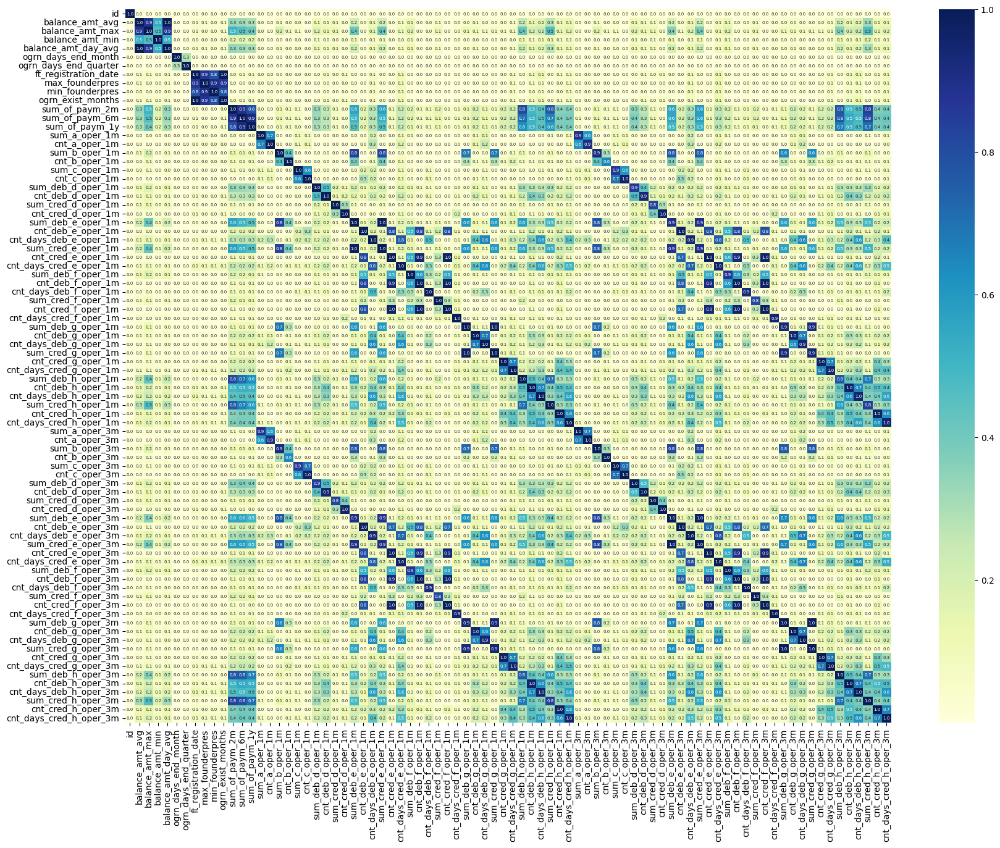

In [15]:
corr_df = train_df.select_dtypes(include='number').corr().abs()


plt.figure(figsize=(20, 15))
dataplot = sns.heatmap(corr_df,
                      cmap="YlGnBu", annot=True, fmt=".1f",
                      annot_kws={'size': 5})
plt.show()

In [30]:
corr_df.unstack()

id                       id                        1.0000
                         balance_amt_avg           0.0041
                         balance_amt_max           0.0038
                         balance_amt_min           0.0045
                         balance_amt_day_avg       0.0042
                                                    ...  
cnt_days_cred_h_oper_3m  cnt_deb_h_oper_3m         0.4712
                         cnt_days_deb_h_oper_3m    0.6136
                         sum_cred_h_oper_3m        0.3946
                         cnt_cred_h_oper_3m        0.6531
                         cnt_days_cred_h_oper_3m   1.0000
Length: 6724, dtype: float64

In [41]:
c1 = corr_df.unstack()


c1.sort_values(ascending=True, inplace=True)
columns_above = {(col1, col2) : c1[col1,col2] for col1, col2 in c1.index if c1[col1,col2] > 0.7 and col1 != col2}

dict(sorted(columns_above.items(), key=lambda item: item[1],reverse=True))

{('ogrn_exist_months', 'ft_registration_date'): 0.9999262519364731,
 ('ft_registration_date', 'ogrn_exist_months'): 0.9999262519364731,
 ('balance_amt_avg', 'balance_amt_day_avg'): 0.9988133232397818,
 ('balance_amt_day_avg', 'balance_amt_avg'): 0.9988133232397818,
 ('cnt_cred_f_oper_3m', 'cnt_cred_f_oper_1m'): 0.9947942182146007,
 ('cnt_cred_f_oper_1m', 'cnt_cred_f_oper_3m'): 0.9947942182146007,
 ('cnt_deb_f_oper_1m', 'cnt_deb_f_oper_3m'): 0.994396623352911,
 ('cnt_deb_f_oper_3m', 'cnt_deb_f_oper_1m'): 0.994396623352911,
 ('cnt_cred_e_oper_1m', 'cnt_cred_e_oper_3m'): 0.9873567392800565,
 ('cnt_cred_e_oper_3m', 'cnt_cred_e_oper_1m'): 0.9873567392800565,
 ('sum_deb_g_oper_3m', 'sum_cred_g_oper_3m'): 0.9848016292499805,
 ('sum_cred_g_oper_3m', 'sum_deb_g_oper_3m'): 0.9848016292499805,
 ('cnt_deb_e_oper_1m', 'cnt_deb_e_oper_3m'): 0.9821426803330434,
 ('cnt_deb_e_oper_3m', 'cnt_deb_e_oper_1m'): 0.9821426803330434,
 ('sum_deb_e_oper_3m', 'sum_cred_e_oper_3m'): 0.9817899801929464,
 ('sum_cre

### Пустые значения

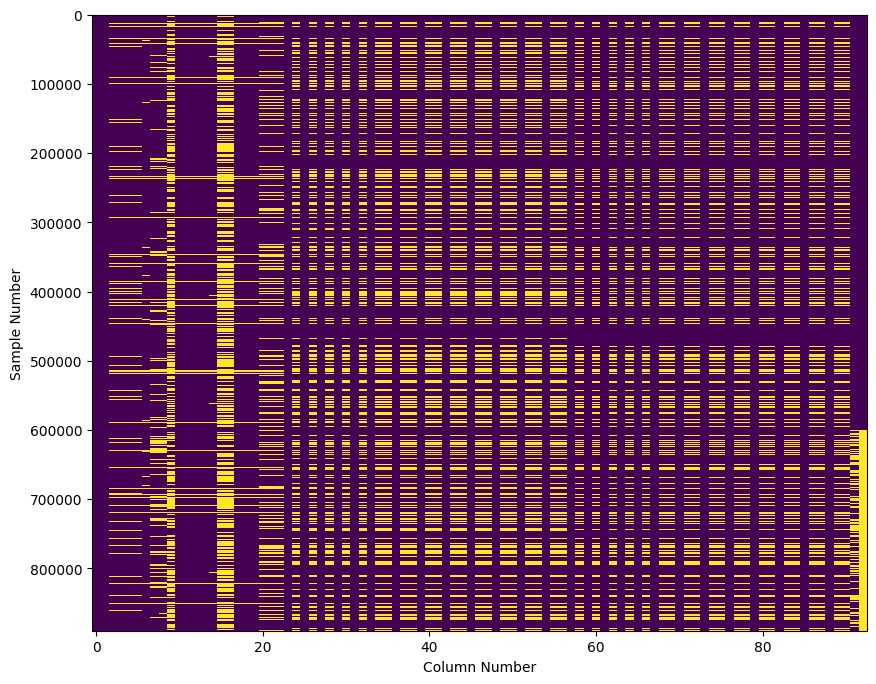

In [22]:
plt.figure(figsize=(10, 8))
plt.imshow(df.isna(), aspect="auto", interpolation="nearest", cmap="viridis")
plt.xlabel("Column Number")
plt.ylabel("Sample Number")
plt.show()

### Уникальные значения

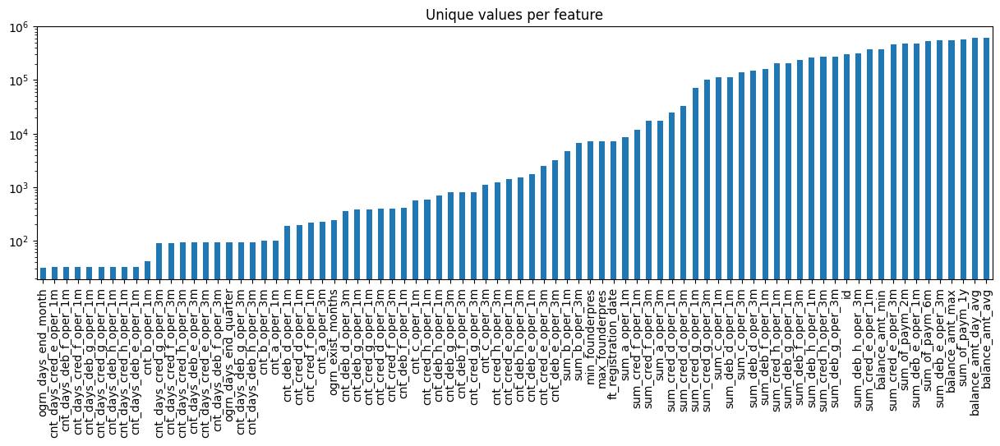

In [33]:
unique_values = df.select_dtypes(include="number").nunique().sort_values()

unique_values.plot.bar(logy=True, figsize=(15, 4), title="Unique values per feature");

### Графики

In [53]:
stats = [
    'balance_amt_avg',
    'balance_amt_max',
    'balance_amt_min',
    'balance_amt_day_avg',
    'ogrn_days_end_month',
    'ogrn_days_end_quarter',
    'ft_registration_date',
    'max_founderpres',
    'min_founderpres',
    'ogrn_exist_months',
    'sum_of_paym_2m',
    'sum_of_paym_6m',
    'sum_of_paym_1y'
]

stats_1m = [column for column in df.columns if '1m' in column]

stats_3m = [column for column in df.columns if '3m' in column]

sum([len(stats), len(stats_1m), len(stats_3m)])

81

In [63]:
sns.pairplot(df[stats])
plt.show()

- `lw=0`: Толщина линии графика установлена на 0, что означает отсутствие линии (то есть только точки).
- `marker="."`: Точечный маркер, который будет использоваться на графиках.
- `subplots=True`: Создает отдельные графики для каждого столбца данных.
- `layout=(-1, 4)`: Устанавливает макет для размещения графиков. Здесь `(-1, 4)` означает, что количество строк (-1) будет определено автоматически в зависимости от количества выбранных столбцов, а количество столбцов (4) останется постоянным.
- `figsize=(15, 15)`: Размер фигуры, в данном случае 15x15 дюймов.
- `markersize=1`: Размер маркеров точек на графике.

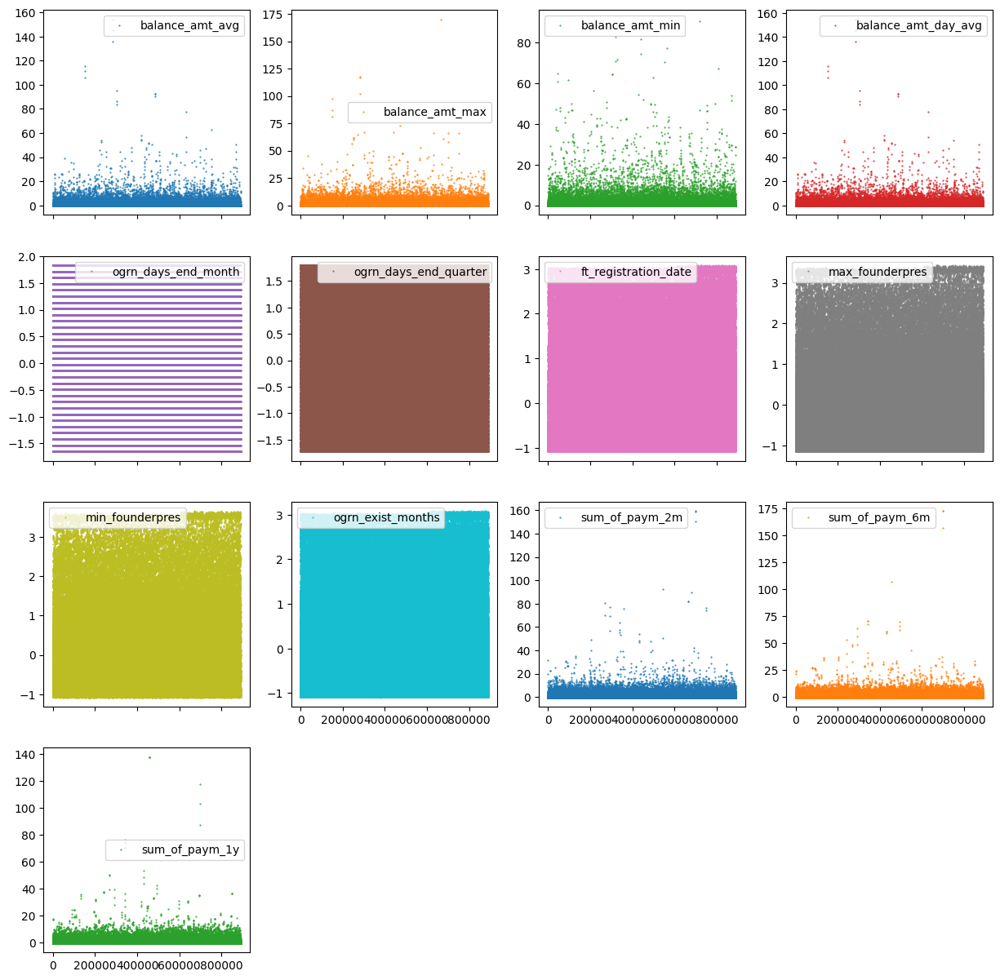

In [58]:
df[stats].plot(lw=0, marker=".", subplots=True, layout=(-1, 4),
          figsize=(15, 15), markersize=1);

In [66]:
fig = go.Figure(data=go.Scatter(x=df['id'], y=df['ogrn_days_end_month'], mode='markers'))

fig.update_layout(title='Scatter Plot for ogrn_days_end_month', xaxis_title='ogrn_days_end_month', yaxis_title='ogrn_days_end_month')

fig.show()
